In [8]:
import pandas  as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn import linear_model 
from sklearn.model_selection import train_test_split 
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error,mean_absolute_error
from datetime import datetime, timedelta

plt.rcParams['figure.figsize'] = [8,5]
plt.rcParams['font.size'] =11
plt.style.use('seaborn-whitegrid')
pd.options.display.max_columns = None

In [9]:
df = pd.read_csv('../data/fbcomments.csv')
print('\nNumber of rows and columns in the data set: ',df.shape)
df.describe()



Number of rows and columns in the data set:  (40949, 28)


,likes,Checkins,Returns,Category,commBase,comm24,comm48,comm24_1,diff2448,baseTime,length,shares,hrs,sun_pub,mon_pub,tue_pub,wed_pub,thu_pub,fri_pub,sat_pub,sun_base,mon_base,tue_base,wed_base,thu_base,fri_base,sat_base,output
count,4.094900e+04,40949.000000,4.089800e+04,40892.000000,40889.000000,40949.000000,40901.00000,40949.000000,40949.000000,40949.000000,40949.000000,38500.000000,40949.000000,40949.000000,39022.000000,40949.000000,40949.000000,37904.000000,40949.000000,40949.000000,40949.000000,38979.000000,40949.000000,40949.000000,40949.000000,40949.000000,40949.000000,40949.000000
mean,1.313814e+06,4676.133752,4.485611e+04,24.272449,55.793783,22.186647,19.67260,52.631591,2.536961,35.322035,163.652470,124.571610,23.767833,0.122347,0.126313,0.149747,0.157489,0.135579,0.146157,0.136926,0.141640,0.088663,0.137635,0.148599,0.150846,0.143886,0.144888,7.322889
std,6.785752e+06,20593.184863,1.109917e+05,19.950812,137.062715,77.124263,71.11712,128.179920,94.202974,20.916864,376.264387,974.140185,1.919829,0.327691,0.332206,0.356828,0.364265,0.342346,0.353268,0.343774,0.348684,0.284261,0.344520,0.355698,0.357903,0.350979,0.351992,35.494550
min,3.600000e+01,0.000000,0.000000e+00,1.000000,0.000000,0.000000,0.00000,0.000000,-1366.000000,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,3.673400e+04,0.000000,7.010000e+02,9.000000,2.000000,0.000000,0.00000,2.000000,-6.000000,17.000000,38.000000,2.000000,24.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,2.929110e+05,0.000000,7.237000e+03,18.000000,11.000000,2.000000,0.00000,10.000000,0.000000,35.000000,97.000000,15.000000,24.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,1.204214e+06,99.000000,5.141100e+04,32.000000,46.000000,12.000000,9.00000,44.000000,3.000000,53.000000,172.000000,67.000000,24.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.000000
max,4.869723e+08,186370.000000,6.089942e+06,106.000000,2341.000000,2079.000000,1605.00000,2184.000000,2079.000000,72.000000,21480.000000,144860.000000,24.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1305.000000


In [10]:
cols_numerical=['likes', 'Checkins', 'Returns', 'Category', 'commBase', 'comm24',
       'comm48', 'comm24_1', 'diff2448', 'baseTime', 'length', 'shares', 'hrs']
cols_binary=['sun_pub', 'mon_pub', 'tue_pub', 'wed_pub', 'thu_pub', 'fri_pub',
       'sat_pub', 'sun_base', 'mon_base', 'tue_base', 'wed_base', 'thu_base',
       'fri_base', 'sat_base']
cols_target=['output']

In [11]:
print('Check binary columns distribution:')
dfr=pd.DataFrame(data=[df[col].value_counts().values for col in cols_binary], index=cols_binary)
dfr['pct']=dfr[1]/(dfr[0]+dfr[1])
dfr

Check binary columns distribution:


,0,1,pct
sun_pub,35939,5010,0.122347
mon_pub,34093,4929,0.126313
tue_pub,34817,6132,0.149747
wed_pub,34500,6449,0.157489
thu_pub,32765,5139,0.135579
fri_pub,34964,5985,0.146157
sat_pub,35342,5607,0.136926
sun_base,35149,5800,0.141640
mon_base,35523,3456,0.088663
tue_base,35313,5636,0.137635


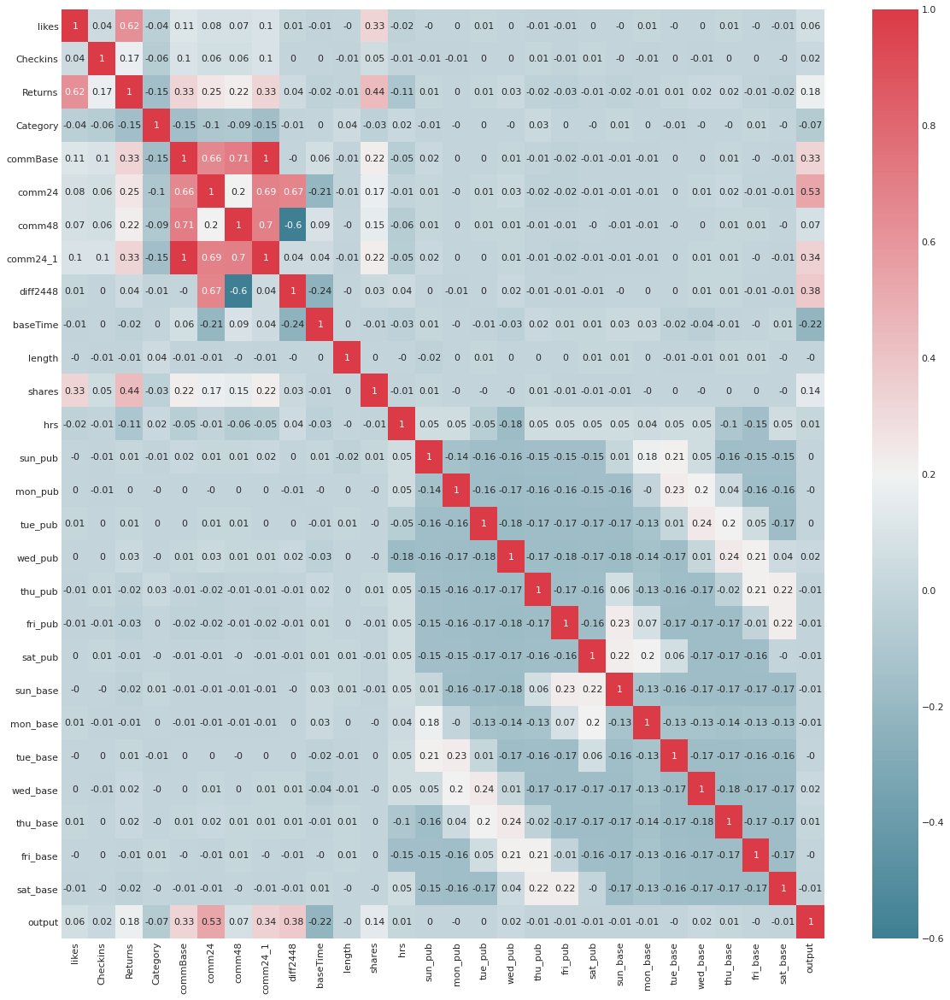

In [12]:
def correlation_heatmap(df):
    _,ax=plt.subplots(figsize=(20,20))
    colormap=sns.diverging_palette(220,10,as_cmap=True)
    sns.heatmap(df.corr().round(2),annot=True,cmap=colormap)
    
correlation_heatmap(df)

In [13]:
print('\ncomm24_1 and commBase features have high correlation, so it is worth to remove one of them.')
dfr=pd.DataFrame(data=df.isna().sum()/df.shape[0], index=df.columns, columns=['nulls']).sort_values(by='nulls', ascending=False)
display(dfr[dfr.nulls>0])
print('\nThere is no features with a large ammount of null values. ')
print('\nDue to distribution of binary columns I fill NaNs with zero there and drop the rest rows with nulls.')
print('\nAlso I choose to drop commBase column and keep comm24_1, because first contains nulls.')
cols_numerical=['likes', 'Checkins', 'Returns', 'Category', 'comm24', 'comm48', 'comm24_1', 'diff2448', 'baseTime', 'length', 'shares', 'hrs']
df=df[cols_numerical+cols_binary+cols_target]
df.fillna({'thu_pub':0, 'mon_base':0, 'mon_pub':0}, inplace=True)
df=df.dropna()
print('\nNumber of rows and columns in the data set: ',df.shape)


comm24_1 and commBase features have high correlation, so it is worth to remove one of them.


,nulls
thu_pub,0.074361
shares,0.059806
mon_base,0.048109
mon_pub,0.047059
commBase,0.001465
Category,0.001392
Returns,0.001245
comm48,0.001172



There is no features with a large ammount of null values. 

Due to distribution of binary columns I fill NaNs with zero there and drop the rest rows with nulls.

Also I choose to drop commBase column and keep comm24_1, because first contains nulls.

Number of rows and columns in the data set:  (38360, 27)


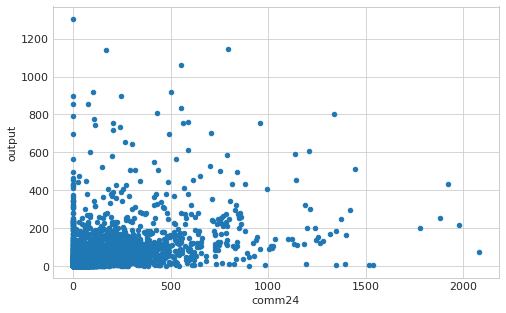

In [14]:
df.plot.scatter(x='comm24', y='output');

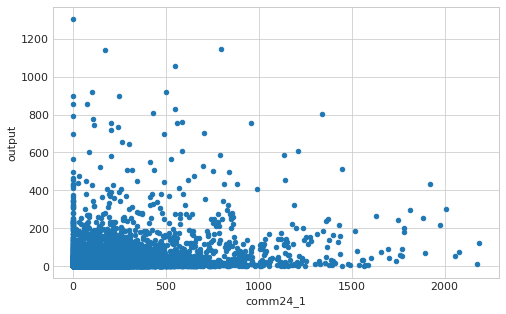

In [15]:
df.plot.scatter(x='comm24_1', y='output');

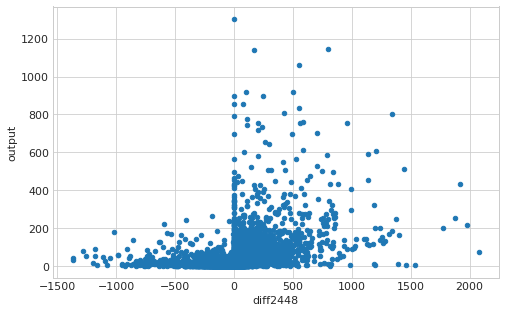

In [16]:
df.plot.scatter(x='diff2448', y='output');

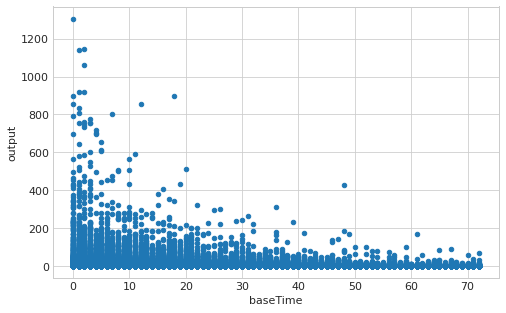

In [17]:
df.plot.scatter(x='baseTime', y='output');

The target variable is highly disbalanced:


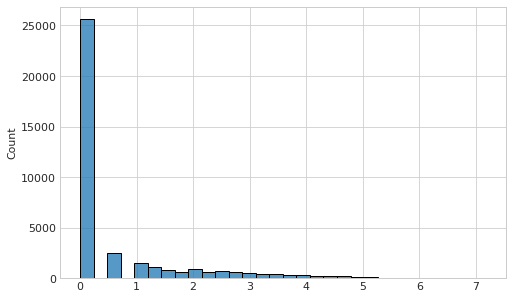

In [18]:
print('The target variable is highly disbalanced:')
sns.histplot([np.log(x) if x>0 else 0 for x in df['output']],bins=30);

## Data prepare

In [19]:
scaler = MinMaxScaler()
X=np.hstack((scaler.fit_transform(df[cols_numerical]),df[cols_binary]))
Y=df[cols_target].values.ravel()
x_train, x_test, y_train, y_test = train_test_split(X, Y, test_size=0.3,random_state=42)

In [20]:
ds=datetime.now()
model = linear_model.LinearRegression() 
model.fit(x_train, y_train) 
yhat_lin = model.predict(x_test)
rmse=mean_squared_error(y_test, yhat_lin, squared=False)
mae=mean_absolute_error(y_test, yhat_lin)
print('LinearRegression score={:.4f}, RMSE={:.4f}, MAE={:.4f}, completed in {:.4f} s.'.format(model.score(x_test, y_test),rmse,mae, (datetime.now()-ds).total_seconds()))


LinearRegression score=0.3665, RMSE=25.8130, MAE=8.0713, completed in 0.0401 s.


In [22]:
sk_theta = [model.intercept_]+list(model.coef_)
len(sk_theta)

27

In [124]:
ds=datetime.now()
model = linear_model.LogisticRegression(max_iter=500)
model.fit(x_train, y_train) 
yhat_log = model.predict(x_test)
rmse=mean_squared_error(y_test, yhat_log, squared=False)
mae=mean_absolute_error(y_test, yhat_log)
print('LogisticRegression score={:.4f}, RMSE={:.4f}, MAE={:.4f}, completed in {:.4f} s.'.format(model.score(x_test, y_test),rmse,mae, (datetime.now()-ds).total_seconds()))

LogisticRegression score=0.5387, RMSE=32.1461, MAE=6.9859, completed in 197.4967 s.


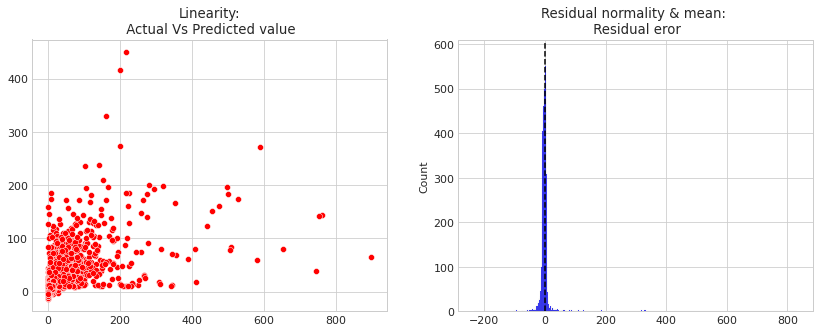

In [126]:
# Check for Linearity
f = plt.figure(figsize=(14,5))
ax = f.add_subplot(121)
sns.scatterplot(x=y_test,y=yhat_lin,ax=ax,color='r')
ax.set_title('Linearity:\n Actual Vs Predicted value')

# Check for Residual normality & mean
ax = f.add_subplot(122)
sns.histplot((y_test - yhat_lin),ax=ax,color='b')
ax.axvline((y_test - yhat_lin).mean(),color='k',linestyle='--')
ax.set_title('Residual normality & mean: \n Residual eror');


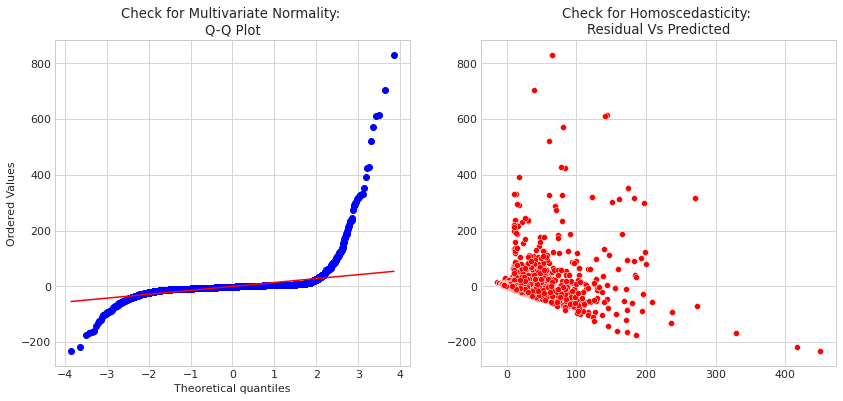

In [127]:
f,ax = plt.subplots(1,2,figsize=(14,6))
import scipy as sp
_,(_,_,r)= sp.stats.probplot((y_test - yhat_lin),fit=True,plot=ax[0])
ax[0].set_title('Check for Multivariate Normality: \nQ-Q Plot')

#Check for Homoscedasticity
sns.scatterplot(y = (y_test - yhat_lin), x= yhat_lin, ax = ax[1],color='r') 
ax[1].set_title('Check for Homoscedasticity: \nResidual Vs Predicted');

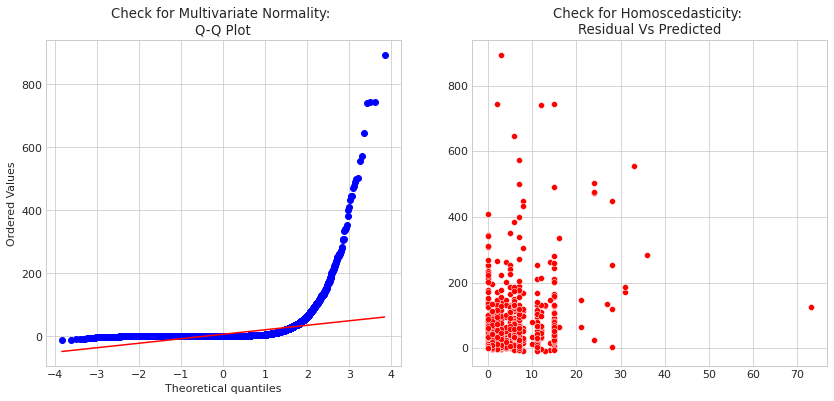

In [128]:
f,ax = plt.subplots(1,2,figsize=(14,6))
_,(_,_,r)= sp.stats.probplot((y_test - yhat_log),fit=True,plot=ax[0])
ax[0].set_title('Check for Multivariate Normality: \nQ-Q Plot')

#Check for Homoscedasticity
sns.scatterplot(y = (y_test - yhat_log), x= yhat_log, ax = ax[1],color='r') 
ax[1].set_title('Check for Homoscedasticity: \nResidual Vs Predicted');